

### U-NET segmentation on pciSeq/ISS image
#### Builds a U-NET model
#### trains it on tiles of 256 x 256 images (data from Kaggle)
#### then we tile the pciSeq/ISS image
#### predicts the cell segments per tile using the U-NET
#### stitches the image back
#### computes the cell centroids and cell coordinates for further downstream

In [1]:
import os
import sys

import numpy as np
np.set_printoptions(threshold=sys.maxsize)

import time

from matplotlib.patches import Polygon

from PIL import Image, ImageDraw
from skimage import measure #package is scikit-image

import pandas as pd


import matplotlib.pyplot as plt
plt.close('all')

from scipy.spatial import distance

import phenograph as pg
import cv2

from sklearn.mixture import BayesianGaussianMixture
from sklearn.manifold import TSNE

#import matplotlib
#matplotlib.use('Agg')

import random
from scipy.stats import zscore

import scipy.stats as stats
from scipy.stats import multivariate_normal

from joblib import Parallel, delayed
import multiprocessing

import scipy.io
from scipy.io import mmread

import colorsys

import seaborn as sns
import fastcluster


from scipy.spatial import distance

from numpy.lib.stride_tricks import as_strided

import tifffile

from matplotlib import colors as mcolors

from scipy.spatial import ConvexHull

In [2]:

import skimage.color

from scipy.sparse import load_npz
from scipy.sparse import coo_matrix
import pciSeq
from pciSeq import utils

PyDIPjavaio unavailable:
dlopen(/opt/anaconda3/lib/python3.7/site-packages/diplib/PyDIPjavaio.cpython-37m-darwin.so, 2): Library not loaded: @rpath/libjvm.dylib
  Referenced from: /opt/anaconda3/lib/python3.7/site-packages/diplib/libDIPjavaio.dylib
  Reason: image not found

load_jvm returned '/opt/anaconda3/lib/server/libjvm.dylib'


In [3]:
############
#### define path variables for data, Python code, R code etc
############


path_data = os.getcwd() # or desired location to where the pciSeq_ISS folder is saved to 
path_molecules = os.path.join(path_data+'/pciSeq_4-3.csv')
fov_count = 'current_run/'

In [4]:


def connectpoints(x,y,p1,p2):
    x1, x2 = x[p1], x[p2]
    y1, y2 = y[p1], y[p2]
    plt.plot([x1,x2],[y1,y2],'k-',linewidth=0.5)


colours=[ "darkviolet", "red", "orange", "limegreen", "blue", "purple", "seagreen","gold","lightpink","thistle","mistyrose","saddlebrown","slategrey",
            "palevioletred","mediumvioletred","yellowgreen","darkolivegreen","lemonchiffon","chocolate","lightsalmon","lightcyan","lightblue", "black"]



def setdiff2d(lst1,lst2):
    aset = set([tuple(x) for x in lst1])
    bset = set([tuple(x) for x in lst2])
    l = np.array([x for x in aset - bset])
    return l

def is_nan(x):
    return (x is np.nan or x != x)


def get_colors(num_colors):
    colors=[]
    for i in np.arange(0., 360., 360. / num_colors):
        r_c = np.random.rand()
        hue = i/360.
        lightness = (50 + r_c * 10)/100.
        saturation = (90 + r_c * 10)/100.
        colors.append(colorsys.hls_to_rgb(hue, lightness, saturation))
    return colors

#set clustering algorithm choice
bayes_MM = 0 # to run the DPMM else set to 0 for phenograph

num_comp = 10

neigh_size = 100#15

dist_ub = 150
dist_ub_1 = 300

#dist_threshold = 100

dpi_set = 100

num_pg_k = 50

num_fov = 1

#sc_norm = 'zscore' # or 'log'
#random.seed(9001)

mRNA_asgn_counter = np.zeros([num_fov,1])

s_size = 20

#num_colour = 50
win_size = 150
win_size_1 = 500

#cm = plt.cm.get_cmap('tab20',num_colour)
#cm = get_colors(num_colour)
cm = colours

f_size=10

fig2p = 0

z = 2

num_cell_fov = np.zeros(num_fov, dtype=int)



In [5]:
colors = dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS)

#https://matplotlib.org/examples/color/named_colors.html
by_hsv = sorted((tuple(mcolors.rgb_to_hsv(mcolors.to_rgba(color)[:3])), name)
                for name, color in colors.items())
sorted_names = [name for hsv, name in by_hsv]
#len(sorted_names)

In [6]:
pciseq_data = os.path.join(path_data + '/DAPI_4-3_mask.tif')

with tifffile.TiffFile(pciseq_data) as tif:
     imagej_hyperstack = tif.asarray()
     imagej_metadata = tif.imagej_metadata

In [7]:
imagej_hyperstack.shape

(20645, 31662)

In [8]:
imagej_metadata

{'ImageJ': '1.52n'}

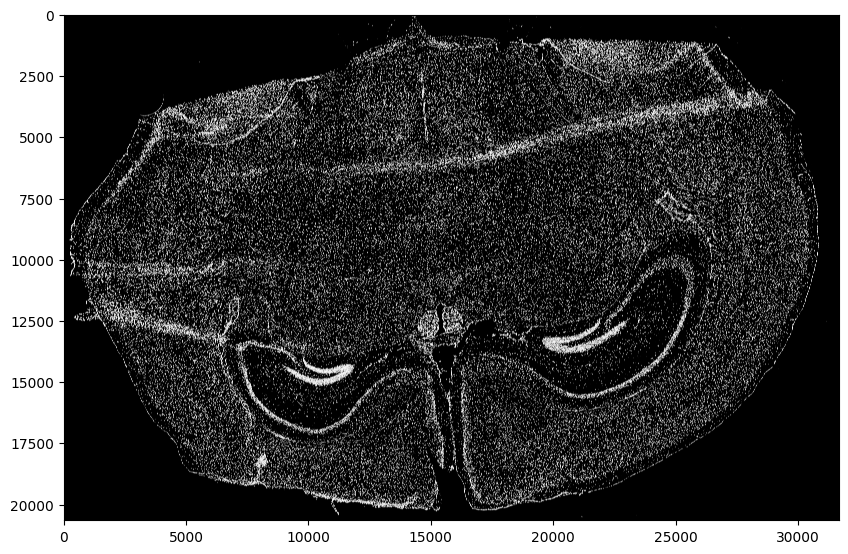

In [9]:
plt.figure(figsize=(10,10),dpi=dpi_set)
plt.imshow(imagej_hyperstack[0:20645, 0:31662], 'gray', interpolation='gaussian')


In [9]:
codebook= np.array(pd.read_csv(path_molecules,header=0, float_precision=None).values)
# get the gene names
gene_pciSeq = codebook[:,2]# [3:,0]


In [10]:
uni_genes_ct = np.unique(gene_pciSeq).shape[0]
uni_genes = np.unique(gene_pciSeq)

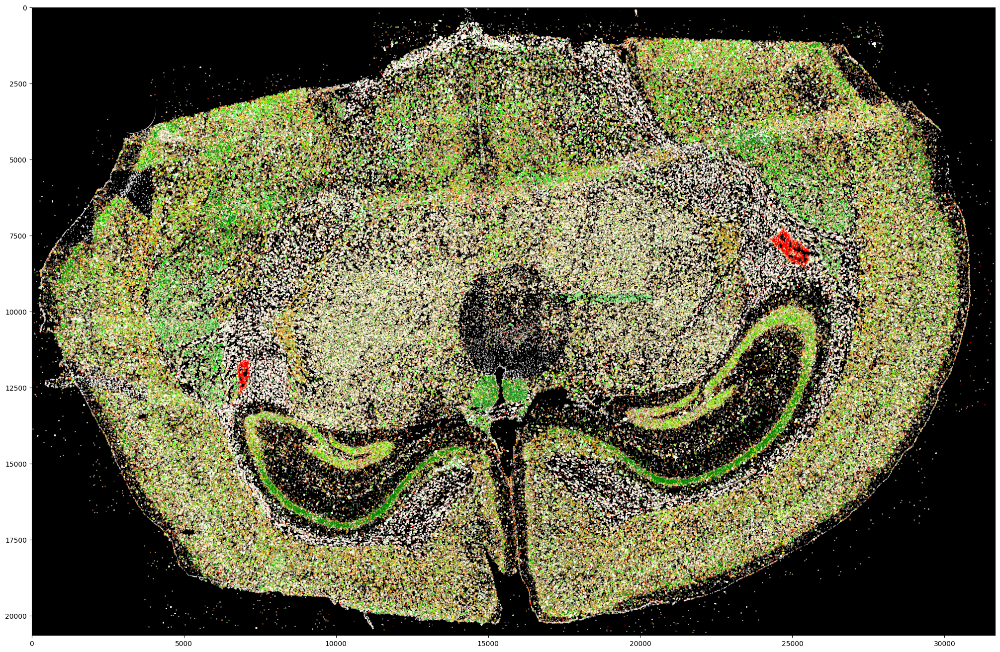

In [12]:
#color=sorted_names[int(gene_id)])

plt.figure(figsize=(25,25),dpi=dpi_set)
plt.imshow(imagej_hyperstack[0:20645, 0:31662], 'gray', interpolation='gaussian')

for i in range(uni_genes_ct):
    genes_id = np.array(np.where(uni_genes[i]==gene_pciSeq)).flatten()
    
    
    plt.plot(codebook[genes_id,1], codebook[genes_id,0],'.',markersize=2, c=sorted_names[int(i)],alpha=0.5)

In [11]:
np.array(np.where(uni_genes[0]==gene_pciSeq)).flatten().shape

(44068,)

In [12]:
uni_genes

array(['3110035E14Rik', 'Adgrl2', 'Aldoc', 'Arpp21', 'Atp1b1', 'Bcl11b',
       'Calb1', 'Calb2', 'Calm2', 'Cck', 'Cdh13', 'Chodl', 'Chrm2',
       'Cnr1', 'Cort', 'Cox6a2', 'Cpne5', 'Crh', 'Crhbp', 'Crym', 'Cux2',
       'Cxcl14', 'Enc1', 'Enpp2', 'Fam19a1', 'Fos', 'Fxyd6', 'Gabrd',
       'Gad1', 'Gap43', 'Gda', 'Grin3a', 'Hapln1', 'Htr3a', 'Id2',
       'Kcnk2', 'Kit', 'Lamp5', 'Lhx6', 'Ndnf', 'Neurod6', 'Nos1', 'Nov',
       'Npy', 'Npy2r', 'Nr4a2', 'Nrn1', 'Pax6', 'Pcp4', 'Pde1a', 'Penk',
       'Plcxd2', 'Plp1', 'Pthlh', 'Pvalb', 'Pvrl3', 'Qrfpr', 'Rab3c',
       'Rasgrf2', 'Reln', 'Rgs10', 'Rgs12', 'Rgs4', 'Rorb', 'Rprm',
       'Satb1', 'Scg2', 'Sema3c', 'Serpini1', 'Slc17a8', 'Slc24a2',
       'Slc6a1', 'Snca', 'Sncg', 'Sst', 'Sulf2', 'Synpr', 'Tac1', 'Tac2',
       'Th', 'Thsd7a', 'Vip', 'Wfs1', 'Zcchc12'], dtype=object)

##  from pciseq codebase

In [20]:
!pip install pciSeq


You should consider upgrading via the '/opt/anaconda3/bin/python3 -m pip install --upgrade pip' command.


In [13]:
import os
import numpy as np
import pandas as pd
import skimage.color
import matplotlib.pyplot as plt
from scipy.sparse import load_npz
from scipy.sparse import coo_matrix
import pciSeq
from pciSeq import utils

In [14]:
def GetQHulls(labels):
    Nlabels = labels.max()
    hulls = []
    coords = []
    num_cells = 0
    for i in range(Nlabels): # skip label 0 (background)
        curr_coords = np.argwhere(labels == i)
        if curr_coords.shape[0] < 100000 and curr_coords.shape[0] > 1000:
            num_cells += 1
            hulls.append(ConvexHull(curr_coords))
            coords.append(curr_coords)
    return hulls, coords

### UNET segmentation



In [15]:
import os
import sys
import random
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from tqdm import tqdm
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

# pip install --ignore-installed --upgrade keras

from keras.models import Model, load_model
from keras.layers import Input
from keras.layers.core import Dropout, Lambda
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D
from keras.layers.merge import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K

#pip install --ignore-installed --upgrade tensorflow

import tensorflow as tf

from scipy import ndimage

from sklearn.manifold import TSNE

import phenograph as pg
from scipy.stats import zscore

from skimage.color import rgb2gray

from matplotlib.patches import Polygon

import matplotlib

Using TensorFlow backend.


In [16]:
# Set some parameters
IMG_WIDTH = 256#128
IMG_HEIGHT = 256# 128
IMG_CHANNELS = 3
TRAIN_PATH = os.path.join(path_data+'/stage1_train/')
TEST_PATH = os.path.join(path_data+'/stage1_test/')




warnings.filterwarnings('ignore', category=UserWarning, module='skimage')
seed = 42
random.seed = seed
np.random.seed = seed

In [17]:
# Build U-Net model
# code modified from Kaggle 

inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (inputs)

c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (s)
c1 = Dropout(0.1) (c1)
c1 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p1)
c2 = Dropout(0.1) (c2)
c2 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p2)
c3 = Dropout(0.2) (c3)
c3 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p3)
c4 = Dropout(0.2) (c4)
c4 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (p4)
c5 = Dropout(0.3) (c5)
c5 = Conv2D(256, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same') (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u6)
c6 = Dropout(0.2) (c6)
c6 = Conv2D(128, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same') (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u7)
c7 = Dropout(0.2) (c7)
c7 = Conv2D(64, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same') (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u8)
c8 = Dropout(0.1) (c8)
c8 = Conv2D(32, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same') (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (u9)
c9 = Dropout(0.1) (c9)
c9 = Conv2D(16, (3, 3), activation='elu', kernel_initializer='he_normal', padding='same') (c9)

outputs = Conv2D(1, (1, 1), activation='sigmoid') (c9)

model = Model(inputs=[inputs], outputs=[outputs])
model.compile(optimizer='adam', loss='binary_crossentropy') #, metrics=[mean_iou])
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
lambda_1 (Lambda)               (None, 256, 256, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 16) 448         lambda_1[0][0]                   
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 256, 256, 16) 0           conv2d_1[0][0]                   
____________________________________________________________________________________________

In [18]:
#Keras metric

# Define IoU metric
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.int32(y_pred > t)
        
        #y_pred = tf.constant(y_pred > t, dtype=tf.float32)
        y_pred = y_pred > t
        tf.dtypes.cast(y_pred, tf.int32)  # [1, 2], dtype=tf.int32

        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)

In [19]:
# Get train and test IDs
train_ids = next(os.walk(TRAIN_PATH))[1]
test_ids = next(os.walk(TEST_PATH))[1]

In [20]:
# Get and resize train images and masks
X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print('Getting and resizing train images and masks ... ')
sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):
    path = TRAIN_PATH + id_
    img = imread(path + '/images/' + id_ + '.png')[:,:,:IMG_CHANNELS]
    img = resize(img, (IMG_HEIGHT, IMG_WIDTH), mode='constant', preserve_range=True)
    X_train[n] = img
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    for mask_file in next(os.walk(path + '/masks/'))[2]:
        mask_ = imread(path + '/masks/' + mask_file)
        mask_ = np.expand_dims(resize(mask_, (IMG_HEIGHT, IMG_WIDTH), mode='constant', 
                                      preserve_range=True), axis=-1)
        mask = np.maximum(mask, mask_)
    Y_train[n] = mask

Getting and resizing train images and masks ... 


100%|██████████| 670/670 [02:56<00:00,  3.80it/s]


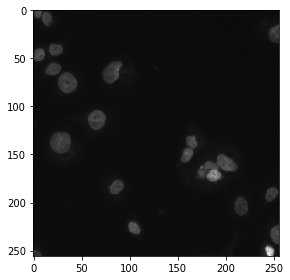

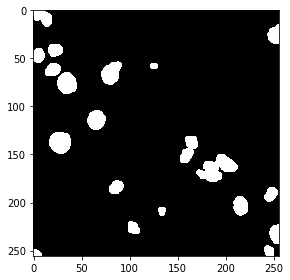

In [21]:
#Let's see if things look all right by drawing some random images and their associated masks.
# Check if training data looks all right
ix = random.randint(0, len(train_ids))
imshow(X_train[ix])
plt.show()
imshow(np.squeeze(Y_train[ix]))
plt.show()

In [25]:
# Fit model
earlystopper = EarlyStopping(patience=5, verbose=1)
checkpointer = ModelCheckpoint('model-dsbowl2018-1.h5', verbose=1, save_best_only=True)
results = model.fit(X_train, Y_train, validation_split=0.1, batch_size=16, epochs=50, 
                    callbacks=[earlystopper, checkpointer])

Train on 603 samples, validate on 67 samples
Epoch 1/50
603/603 [==============================] - 112s 185ms/step - loss: 0.3796 - val_loss: 0.1751

Epoch 00001: val_loss improved from inf to 0.17505, saving model to model-dsbowl2018-1.h5
Epoch 2/50
603/603 [==============================] - 106s 175ms/step - loss: 0.1586 - val_loss: 0.1214

Epoch 00002: val_loss improved from 0.17505 to 0.12140, saving model to model-dsbowl2018-1.h5
Epoch 3/50
603/603 [==============================] - 108s 179ms/step - loss: 0.1229 - val_loss: 0.1459

Epoch 00003: val_loss did not improve from 0.12140
Epoch 4/50
603/603 [==============================] - 100s 165ms/step - loss: 0.1107 - val_loss: 0.0955

Epoch 00004: val_loss improved from 0.12140 to 0.09550, saving model to model-dsbowl2018-1.h5
Epoch 5/50
603/603 [==============================] - 100s 165ms/step - loss: 0.0967 - val_loss: 0.0874

Epoch 00005: val_loss improved from 0.09550 to 0.08742, saving model to model-dsbowl2018-1.h5
Epoch 6

### make predictions

In [22]:
# for a single image....prepare the nuclear channels as test images
# using tiles for the entire image

from skimage import io
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb


from skimage import io
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb

# Get and resize test images
IMG_HEIGHT_1 = 7315#1008
IMG_WIDTH_1 = 4529 # 1344 
IMG_CHANNELS_1 = 3

IMG_WIDTH_2 = IMG_HEIGHT_2 = 256


pciseq_image = os.path.join(path_data+'/CA1DapiBoundaries_4-3_right.tiff')

num_colour = 20
cm = plt.cm.get_cmap('tab20', num_colour)

dpi_set = 100

count = 0

pat_num = []


In [23]:
##use the pretrained model 
model = load_model('model-dsbowl2018-1.h5')#, custom_objects={'mean_iou': mean_iou})
preds_train = model.predict(X_train[:int(X_train.shape[0]*0.9)], verbose=1) #sp
preds_val = model.predict(X_train[int(X_train.shape[0]*0.9):], verbose=1) #sp


67/67 [==============================] - 2s 29ms/step


In [24]:
#for fname in os.listdir(path_data):  
#im = io.imread(fname)
im = io.imread(pciseq_image)#,plugin='matplotlib')
print (im.shape)

(4529, 7315)


In [25]:
image = np.flipud(np.fliplr(im))

In [26]:

# apply threshold
thresh = threshold_otsu(image)
print(thresh)
bw = closing(image > thresh, square(3))

# remove artifacts connected to image border
cleared = clear_border(bw)

#image_all_1.append(cleared*100)
image = cleared*100


25118


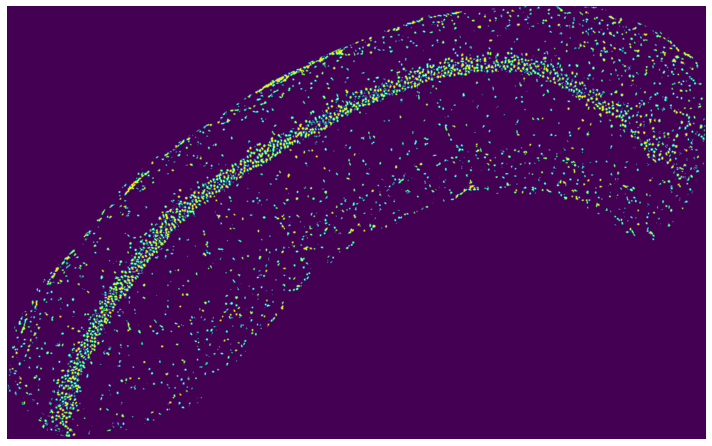

In [27]:
'''
## generate overall thresholded image with artefacts removed
cleared_all = sum(image_all_1)
'''
# label image regions
label_image = label(cleared)
image_label_overlay = label2rgb(label_image, image=cleared)

#image_edges = segmentation.mark_boundaries(cleared, clean_border.astype(np.int))
#plt.figure(figsize=(10,10),dpi=300)
#plt.imshow(image_edges)

fig, ax = plt.subplots(figsize=(10, 10))

ax.imshow(cleared)
#ax.imshow(im[1]+im[0]+im[6])
#ax.imshow(im[0]) #DAPI

ax.set_axis_off()

plt.tight_layout()
plt.show()

#file_name = os.path.join(path_data_output+'segmented_mask_1.png')
#plt.savefig(file_name,dpi='figure')


In [28]:

# Get the test images (2D)

image_new = np.zeros((IMG_HEIGHT_1,IMG_WIDTH_1))
image_new = image

# Downsample the image to 256x256
tiles = [image_new[x:x+IMG_WIDTH_2,y:y+IMG_HEIGHT_2] for x in range(0,image_new.shape[0],IMG_WIDTH_2) for y in range(0,image_new.shape[1],IMG_HEIGHT_2)]

#resize all tiles to be 256x256


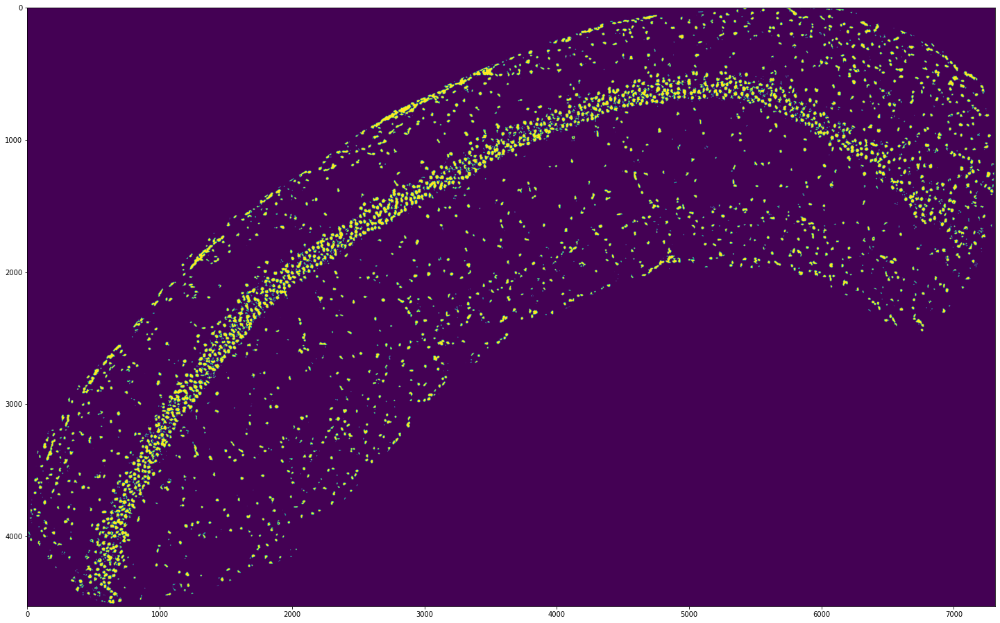

In [29]:
plt.figure(figsize=(25,25))
plt.imshow(image_new)

In [ ]:
for l in range(len(tiles)):
    print(tiles[l].shape)
    plt.figure(figsize=(8,8),dpi=100)
    plt.imshow(tiles[l])

In [33]:
np.max(image_new)

100

In [34]:
image_new.shape

(4529, 7315)

In [35]:
IMG_WIDTH_1

4529

In [36]:
len(tiles)

522

In [37]:
# 3D, copying the image 3 times

image_new_1 = np.zeros((IMG_WIDTH_1,IMG_HEIGHT_1,3))
  
for i in range(3):
    gray = image_new
    image_new_1[:,:,i] = gray #image_all[i]

# Downsample the image to 256x256
tiles_1 = [image_new_1[x:x+IMG_HEIGHT_2,y:y+IMG_WIDTH_2] for x in range(0,image_new.shape[0],IMG_HEIGHT_2) for y in range(0,image_new.shape[1],IMG_WIDTH_2)]
    


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:14,560:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:14,578:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:14,595:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:14,613:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:14,631:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warnin

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:14,738:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:14,756:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:15,018:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,036:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,056:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,075:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,093:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,111:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,130:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:15,166:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,186:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,203:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,222:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,241:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,262:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,285:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:15,519:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,538:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,557:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,574:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,594:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:15,612:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,631:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,649:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,668:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,686:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,705:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:15,725:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)


2022-05-16 17:42:15,837:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:17,167:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,185:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,202:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,221:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,238:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,256:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,274:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:17,382:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,400:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,418:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,436:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,454:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,472:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,490:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:17,658:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,676:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,693:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,710:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,728:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,745:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,763:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:17,836:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,855:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,873:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,891:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,909:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,928:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:17,946:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:18,132:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,151:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,171:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,189:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,207:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,225:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,244:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:18,280:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,299:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,316:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,334:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,353:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,371:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,389:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:18,706:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,727:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,829:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,846:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,863:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,881:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:18,900:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,917:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,935:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,953:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,971:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:18,989:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,006:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:19,132:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,151:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,170:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,187:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,204:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,222:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,240:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:19,339:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,354:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,370:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,389:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,406:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,425:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,444:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:19,553:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,571:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,590:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,608:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,626:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,645:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,664:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)


2022-05-16 17:42:19,822:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,840:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,858:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,875:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,893:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,912:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:19,929:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:20,000:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,018:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,036:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,055:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,072:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,171:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,187:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:20,223:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,242:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,311:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,330:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,347:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:20,595:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,620:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,640:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,659:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,677:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,695:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,712:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:20,946:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,961:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:20,977:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,022:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,040:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:21,057:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,074:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,094:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,111:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,129:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,146:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,165:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:21,491:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:21,507:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,524:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,542:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,561:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,578:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,595:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,613:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:21,937:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:21,954:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,972:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:21,989:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,007:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,025:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,043:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,061:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:22,376:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:22,393:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,412:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,430:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,447:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:22,752:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,775:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,797:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,816:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,834:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:22,851:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:23,136:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,152:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,171:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:23,190:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,207:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,226:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,243:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,262:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,280:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,299:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:23,799:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,823:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:23,851:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,878:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,902:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,926:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,949:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,977:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:23,996:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:24,348:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,362:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,379:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,396:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,414:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,433:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,450:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-0

(256, 256, 3)
(256, 147, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


2022-05-16 17:42:24,798:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,813:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,827:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,844:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
2022-05-16 17:42:24,861:WARNING:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(256, 147, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 256, 3)
(177, 147, 3)


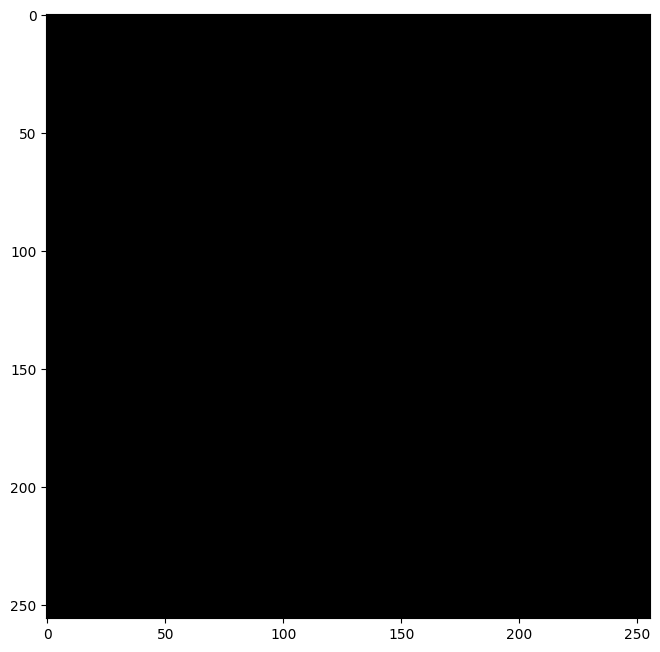

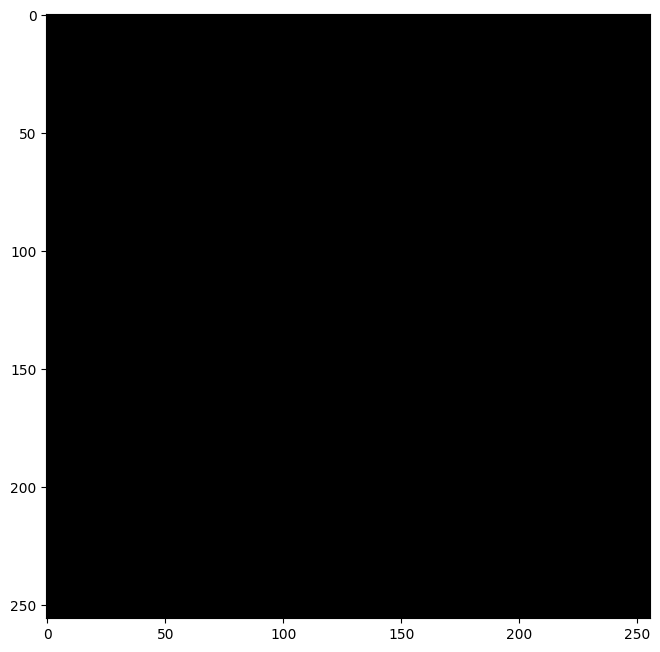

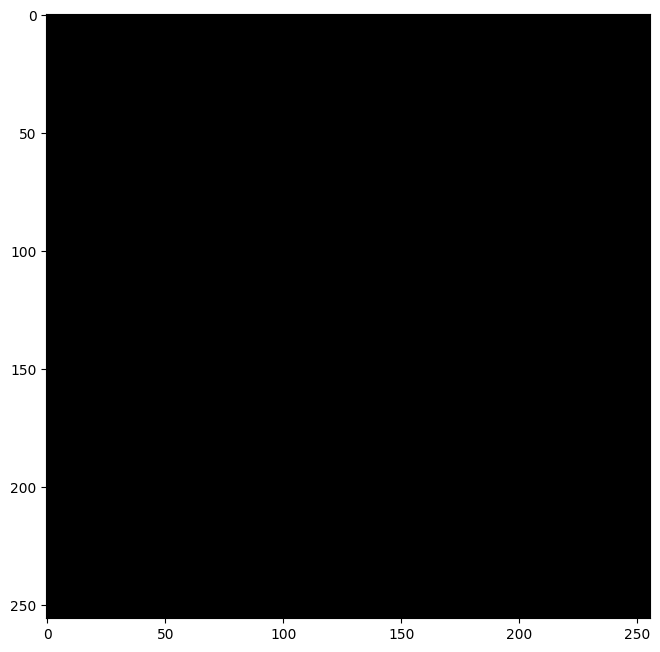

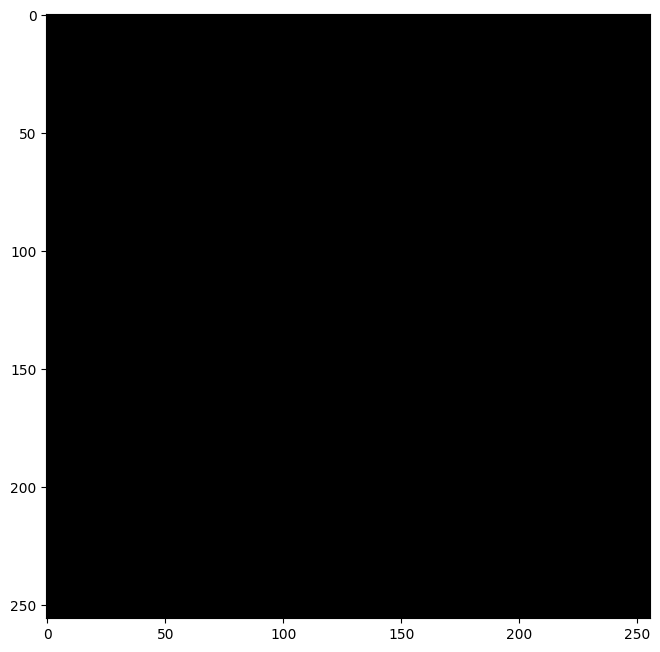

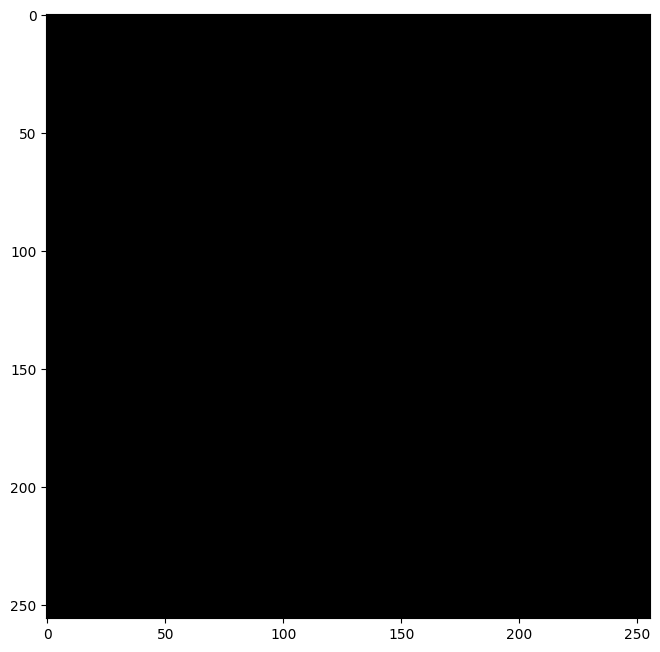

...

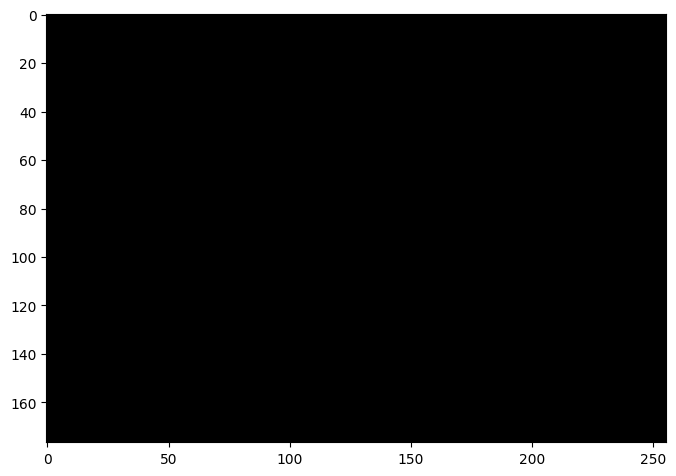

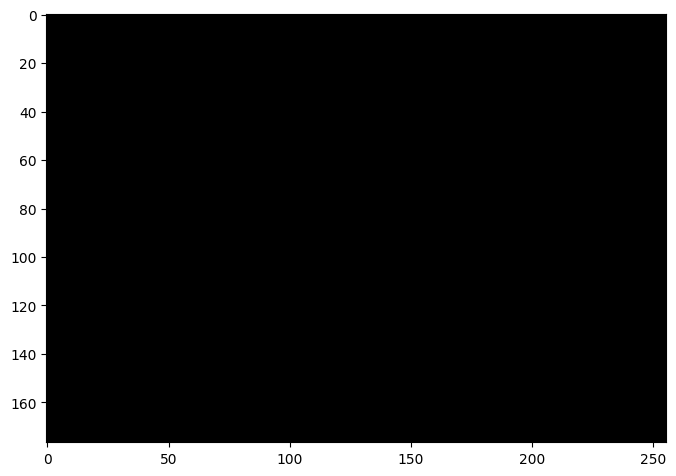

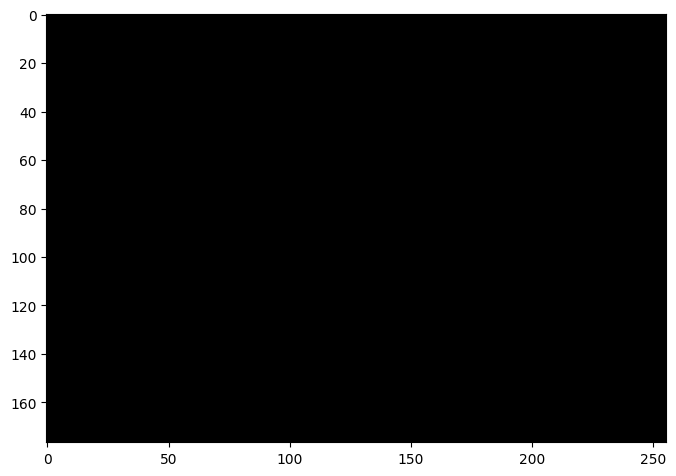

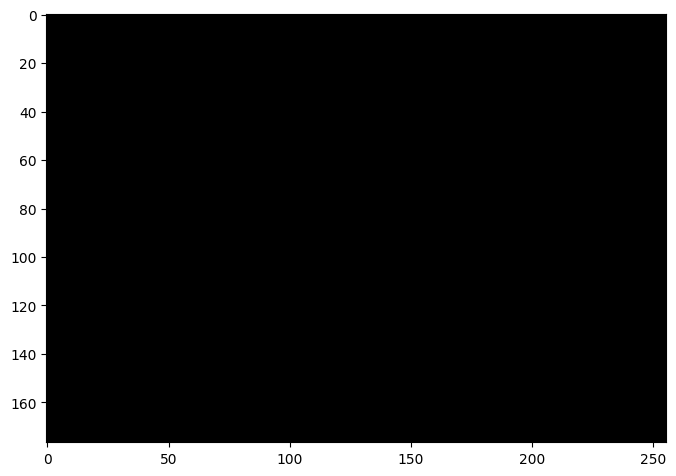

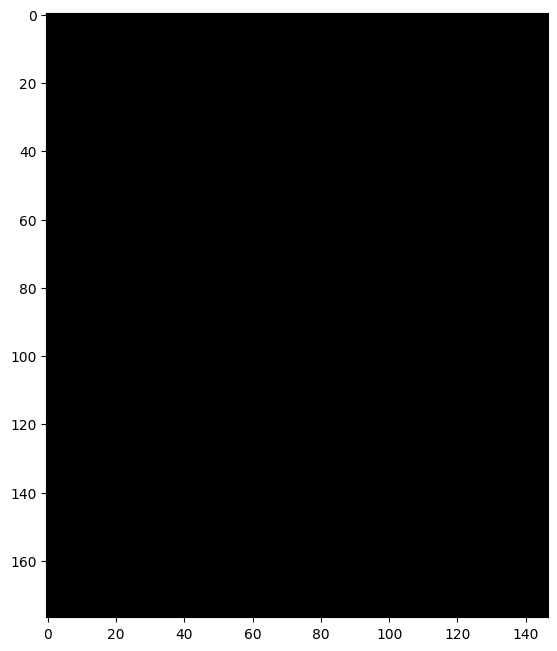

In [38]:
for l in range(len(tiles_1)):
    print(tiles_1[l].shape)
    plt.figure(figsize=(8,8),dpi=100)
    plt.imshow(tiles_1[l])

### make predictions of cell segments per tile


In [39]:
predictions_list = []
label_im_list = []
nb_label_list = []

for l in range(len(tiles_1)):

    X_test_x = np.zeros((1, IMG_HEIGHT_2, IMG_WIDTH_2, 3))
    height_tile = tiles[l].shape[0]
    weight_tile = tiles[l].shape[1]
    X_test_x[0,0:height_tile,0:weight_tile,:] = tiles_1[l]



    ###predict cells for the image

    preds_test = model.predict(X_test_x, verbose=1)

    # Threshold predictions
    preds_train_t = (preds_train > 0.9).astype(np.uint8) #sp
    preds_val_t = (preds_val > 0.9).astype(np.uint8) #sp
    preds_test_t = (preds_test > 0.9).astype(np.uint8) #0.5
    #preds_test_t = (preds_test > 0.0) #.astype(np.uint32) #0.5

    # Create list of upsampled test masks

    #for i in range(len(preds_test)):
    #preds_test_upsampled.append(resize(np.squeeze(preds_test), 
    #                                       (sizes_test_1[0], sizes_test_1[1]), 
    #                                       mode='constant', preserve_range=True))
    predictions_list.append(preds_test_t)


    
    # plot the results
    plt.figure(figsize=(40,40), dpi=300) 
    #plt.imshow(X_test_1[0])
    #plt.imshow(image_new)
    #plt.imshow(image_all_1)
    #preds_test = model.predict(X_test_1, verbose=1)
    ''' open this up to see the images
    #####
    plt.subplot(1,3,2)
    plt.imshow(tiles[l], 'gray', interpolation='none')
    plt.title('Downsampled Original')

    plt.subplot(1,3,1)
    plt.imshow(image_new, 'gray', interpolation='none')
    plt.title('Original')

    #plt.subplot(1,4,4)
    #plt.imshow(preds_test_upsampled[0], 'gray', interpolation='none')
    #plt.title('Cells predicted postthreshold')

    plt.subplot(1,3,3)
    plt.imshow(np.squeeze(preds_test_t), 'gray', interpolation='none')
    plt.title('Cells predicted prethreshold')

    '''
    '''
    # save the image
    file_name = os.path.join(path_python+'/output/output_figures/U_net_summary_FOV'+str(count)+'.png')
    plt.savefig(file_name,dpi='figure')
    plt.close()
    '''
    '''
    plt.figure(figsize=(8,8), dpi=100) 
    plt.imshow(np.squeeze(preds_test_t), 'gray', interpolation='none')
    plt.title('Cells predicted prethreshold')
    '''
    
    # construct the count matrix
    label_im, nb_labels = ndimage.label(preds_test_t)
    sizes = ndimage.sum(preds_test_t, label_im, range(nb_labels+1))

    # 
    label_im_list.append(label_im)
    nb_label_list.append(nb_labels)
    region_cell = []



    count = count + 1

1/1 [==============================] - 0s 53ms/step


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


1/1 [==============================] - 0s 53ms/step


<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

<Figure size 12000x12000 with 0 Axes>

In [40]:
X_train.shape

(670, 256, 256, 3)

In [41]:
7315/256

28.57421875

In [42]:
## stitch the tiles
count = 0
stitched_image =np.zeros((256*18, 256*29))
for x in range(0,256*18,256):
    print('x is', x)
    for y in range(0,256*29,256):
        print('y is', y)
        stitched_image[x:x+256,y:y+256] = predictions_list[count][0,:,:,0]
        #tiles = [image_new[x:x+IMG_WIDTH_2,y:y+IMG_HEIGHT_2]
        
        #
        print(count)
        count = count + 1

x is 0
y is 0
0
y is 256
1
y is 512
2
y is 768
3
y is 1024
4
y is 1280
5
y is 1536
6
y is 1792
7
y is 2048
8
y is 2304
9
y is 2560
10
y is 2816
11
y is 3072
12
y is 3328
13
y is 3584
14
y is 3840
15
y is 4096
16
y is 4352
17
y is 4608
18
y is 4864
19
y is 5120
20
y is 5376
21
y is 5632
22
y is 5888
23
y is 6144
24
y is 6400
25
y is 6656
26
y is 6912
27
y is 7168
28
x is 256
y is 0
29
y is 256
30
y is 512
31
y is 768
32
y is 1024
33
y is 1280
34
y is 1536
35
y is 1792
36
y is 2048
37
y is 2304
38
y is 2560
39
y is 2816
40
y is 3072
41
y is 3328
42
y is 3584
43
y is 3840
44
y is 4096
45
y is 4352
46
y is 4608
47
y is 4864
48
y is 5120
49
y is 5376
50
y is 5632
51
y is 5888
52
y is 6144
53
y is 6400
54
y is 6656
55
y is 6912
56
y is 7168
57
x is 512
y is 0
58
y is 256
59
y is 512
60
y is 768
61
y is 1024
62
y is 1280
63
y is 1536
64
y is 1792
65
y is 2048
66
y is 2304
67
y is 2560
68
y is 2816
69
y is 3072
70
y is 3328
71
y is 3584
72
y is 3840
73
y is 4096
74
y is 4352
75
y is 4608
76
y 

(-0.5, 7314.5, 4528.5, -0.5)

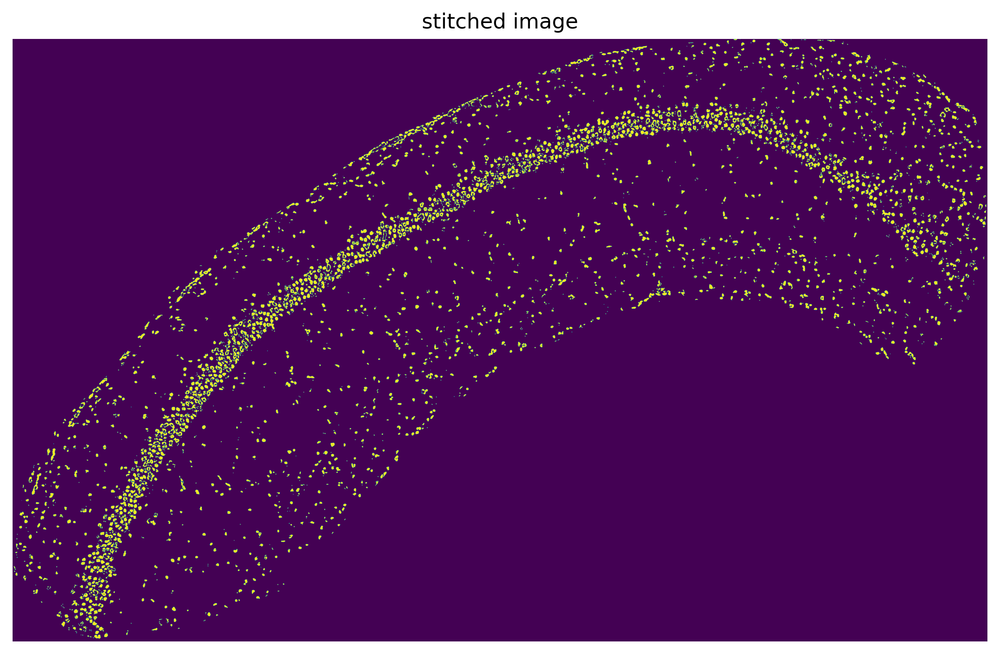

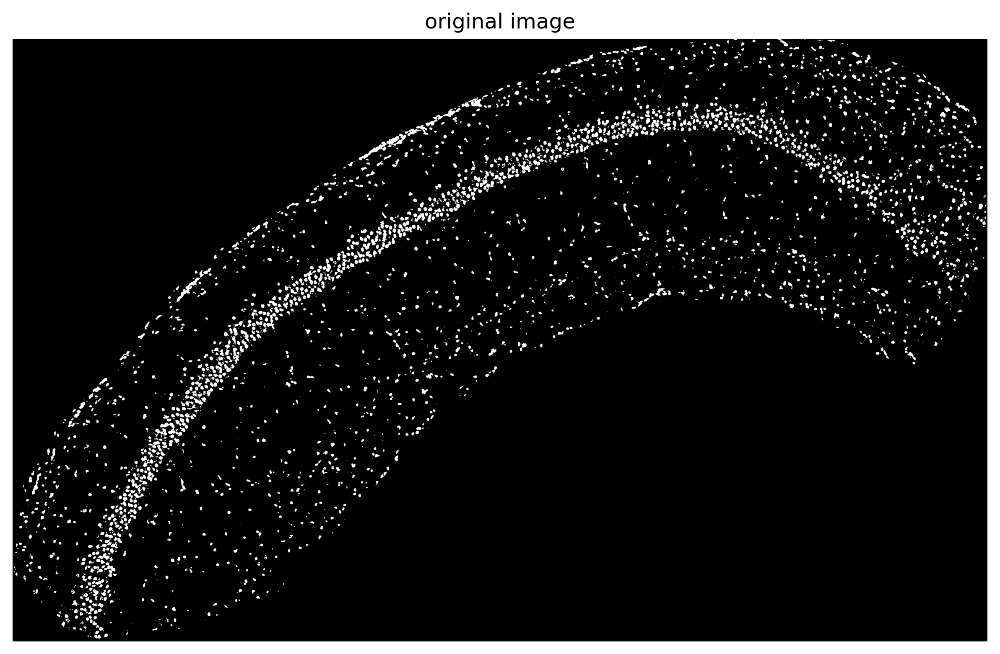

In [43]:
stitched_image_1 = stitched_image[0:IMG_WIDTH_1, 0:IMG_HEIGHT_1]
plt.figure(figsize=(10,10),dpi=300)
plt.imshow(stitched_image_1)
plt.title("stitched image")
plt.axis('off')
#file_name = os.path.join(path_python+'/output/output_figures/Stitched_segments.png')
#plt.savefig(file_name)

plt.figure(figsize=(10,10),dpi=300)
plt.imshow(image_new,cmap="gray")
plt.title("original image")
plt.axis('off')
#file_name = os.path.join(path_python+'/output/output_figures/DAPI_segments.png')#
#plt.savefig(file_name)


In [44]:
# extract regions or cells from the stitched image
# Label pre-segmented images
l_label, l_cell_total = label(stitched_image_1, return_num=True)


# Collect cell features if cell is of minimum size (not segmented debris)
# TODO: clever way of setting this number
l_cells = [cell for cell in regionprops(l_label) if cell['filled_area'] > 15]


In [45]:
l_cell_total

4012

In [46]:
len(l_cells)

3674

In [47]:
all_centroids_1=[]
all_coords_1 = []
for cell in regionprops(l_label):
    if cell['filled_area'] > 15:
        #print(cell['centroid'])
        all_centroids_1.append(cell['centroid'])
        all_coords_1.append(cell['coords'])

In [48]:
len(all_centroids_1)

3674

In [49]:
len(all_coords_1)

3674

In [50]:
all_centroids_1 = np.array(all_centroids_1)
print(all_centroids_1.shape)

(3674, 2)


In [51]:
coords = all_coords_1
print(len(coords))

3674


In [126]:
# save  centroids
df_data = pd.DataFrame(all_centroids_1)
df_data.to_csv(os.path.join(path_data+'/unet/pciSeq_centroids_unet.csv'), header=None, index=None)


In [52]:
all_centroids_1 = np.transpose(all_centroids_1)

In [53]:
all_centroids_1.shape

(2, 3674)